In [1]:
import tensorflow as tf
from tensorflow.python import keras


from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.optimizers import RMSprop
import matplotlib.pyplot as plt

import numpy as np
import cv2
import os

In [2]:
img = image.load_img(r'F:\programme\Animal species recognition\inital_dataset\African Elephant\4.jpg')

In [3]:
cv2.imread(r'F:\programme\Animal species recognition\inital_dataset\African Elephant\4.jpg')

array([[[124,  94,  59],
        [124,  94,  59],
        [125,  95,  60],
        ...,
        [124,  94,  77],
        [123,  93,  76],
        [123,  93,  76]],

       [[124,  94,  59],
        [124,  94,  59],
        [125,  95,  60],
        ...,
        [124,  94,  77],
        [124,  94,  77],
        [123,  93,  76]],

       [[124,  94,  59],
        [124,  94,  59],
        [125,  95,  60],
        ...,
        [125,  95,  78],
        [124,  94,  77],
        [124,  94,  77]],

       ...,

       [[ 45,  41,  47],
        [ 55,  51,  57],
        [ 58,  56,  62],
        ...,
        [ 49,  38,  40],
        [ 48,  37,  39],
        [ 48,  37,  39]],

       [[ 46,  42,  48],
        [ 48,  44,  50],
        [ 51,  47,  53],
        ...,
        [ 48,  37,  39],
        [ 47,  36,  38],
        [ 47,  36,  38]],

       [[ 62,  58,  64],
        [ 56,  52,  58],
        [ 55,  51,  57],
        ...,
        [ 47,  36,  38],
        [ 47,  36,  38],
        [ 46,  35,  37]]

In [4]:
cv2.imread(r'F:\programme\Animal species recognition\inital_dataset\African Elephant\4.jpg').shape

(256, 256, 3)

In [5]:
train = ImageDataGenerator(rescale = 1/255)
test = ImageDataGenerator(rescale = 1/255)

In [6]:
train_dataset = train.flow_from_directory(r'F:\programme\Animal species recognition\inital_dataset',
                                         target_size = (256,256),
                                         batch_size = 3,
                                         class_mode = 'binary')

test_dataset = test.flow_from_directory(r'F:\programme\Animal species recognition\test_dataset',
                                         target_size = (256,256),
                                         batch_size = 3,
                                         class_mode = 'binary')

Found 3628 images belonging to 10 classes.
Found 180 images belonging to 10 classes.


In [7]:
train_dataset.class_indices

{'African Elephant': 0,
 'Amur Leopard': 1,
 'Arctic Fox': 2,
 'Black Rhino': 3,
 'Black Spider Monkey': 4,
 'Bluefin Tuna': 5,
 'Brown Bear': 6,
 'Chimpanzee': 7,
 'European Rabbit': 8,
 'Orangutan': 9}

In [8]:
train_dataset.classes

array([0, 0, 0, ..., 9, 9, 9])

In [9]:
'''model = tf.keras.models.Sequential([tf.keras.layers.Conv2D(16,(3,3),activation = 'relu',, input_shape(256,256,3)),
                                   tf.keras.layers.MaxPool2D(2,2),
                                    
                                    tf.keras.layers.Conv2D(32,(3,3),activation = 'relu'),
                                   tf.keras.layers.MaxPool2D(2,2),
                                    
                                    tf.keras.layers.Conv2D(64,(3,3),activation = 'relu'),
                                   tf.keras.layers.MaxPool2D(2,2),
                                    
                                    
                                    tf.keras.layers.Dense(512,activation = 'relu'),
                                    
                                    
                                    tf.keras.layers.Dense(1,activation = 'softmax') #softmax
                                   ])'''

"model = tf.keras.models.Sequential([tf.keras.layers.Conv2D(16,(3,3),activation = 'relu',, input_shape(256,256,3)),\n                                   tf.keras.layers.MaxPool2D(2,2),\n                                    \n                                    tf.keras.layers.Conv2D(32,(3,3),activation = 'relu'),\n                                   tf.keras.layers.MaxPool2D(2,2),\n                                    \n                                    tf.keras.layers.Conv2D(64,(3,3),activation = 'relu'),\n                                   tf.keras.layers.MaxPool2D(2,2),\n                                    \n                                    \n                                    tf.keras.layers.Dense(512,activation = 'relu'),\n                                    \n                                    \n                                    tf.keras.layers.Dense(1,activation = 'softmax') #softmax\n                                   ])"

In [10]:
model = tf.keras.models.Sequential()
model.add(tf.keras.layers.Flatten())
model.add(tf.keras.layers.Dense(128, activation=tf.nn.relu))
model.add(tf.keras.layers.Dense(128, activation=tf.nn.relu))
model.add(tf.keras.layers.Dense(10, activation=tf.nn.softmax))

In [11]:
model.compile(loss='binary_crossentropy',
             optimizer = RMSprop(lr=0.001),
              metrics = ['accuracy'])

In [12]:
model_fit = model.fit(train_dataset,
                     steps_per_epoch = 3,
                     epochs = 10,
                     validation_data = test_dataset)

Epoch 1/10
3/3 [==============================] - 15s 5s/step - loss: 43.3325 - accuracy: 0.0000e+00 - val_loss: 57.1161 - val_accuracy: 0.1000
Epoch 2/10
3/3 [==============================] - 4s 2s/step - loss: 70.3495 - accuracy: 0.0556 - val_loss: 57.1161 - val_accuracy: 0.1000
Epoch 3/10
3/3 [==============================] - 4s 1s/step - loss: 76.1850 - accuracy: 0.0972 - val_loss: 57.1161 - val_accuracy: 0.1000
Epoch 4/10
3/3 [==============================] - 4s 1s/step - loss: 50.0969 - accuracy: 0.2361 - val_loss: 57.1161 - val_accuracy: 0.1000
Epoch 5/10
3/3 [==============================] - 4s 2s/step - loss: 33.7918 - accuracy: 0.0000e+00 - val_loss: 57.1161 - val_accuracy: 0.1000
Epoch 6/10
3/3 [==============================] - 3s 1s/step - loss: 63.3126 - accuracy: 0.1806 - val_loss: 57.1338 - val_accuracy: 0.1000
Epoch 7/10
3/3 [==============================] - 3s 1s/step - loss: 68.4615 - accuracy: 0.1528 - val_loss: 57.1338 - val_accuracy: 0.1000
Epoch 8/10
3/3 [==

In [14]:
img = image.load_img(r'F:\programme\Animal species recognition\test\test.jpg',target_size=(256,256,3)) #image read with resize

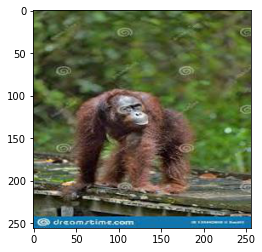

In [15]:
plt.imshow(img)

In [16]:
x = image.img_to_array(img)
x= np.expand_dims(x, axis = 0)
images = np.vstack([x])


In [17]:
images.ndim

4

In [18]:
images.shape

(1, 256, 256, 3)

In [19]:
val = model.predict(images)

In [20]:
print(val)

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


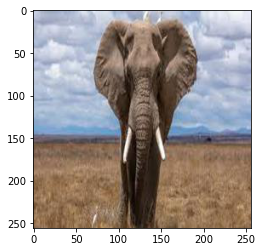

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


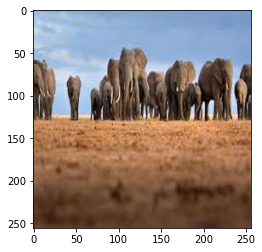

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


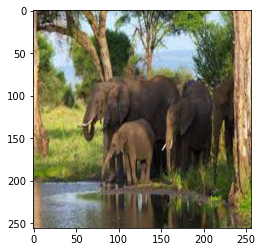

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


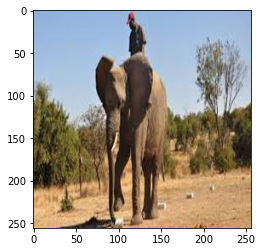

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


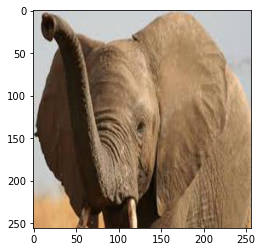

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


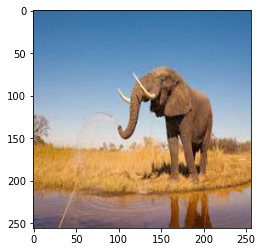

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


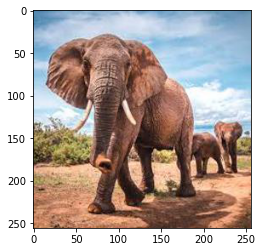

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


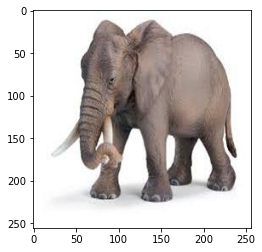

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


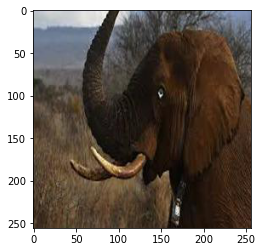

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


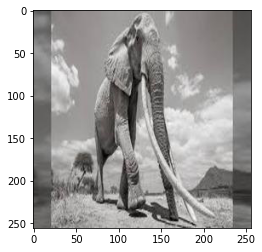

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


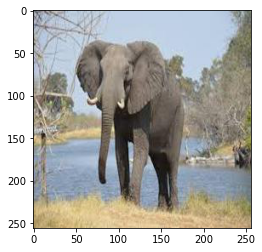

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


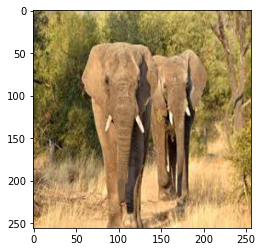

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


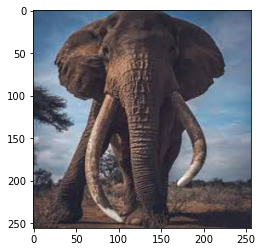

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


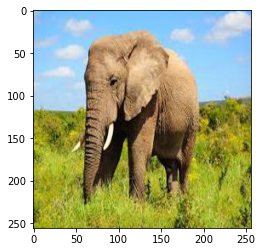

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


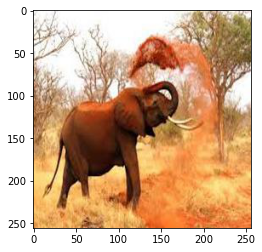

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


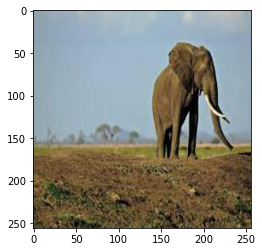

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


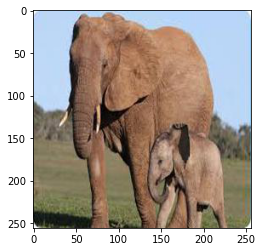

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


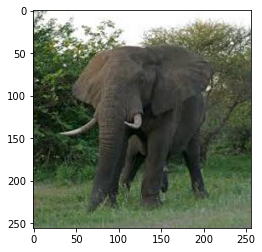

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


In [22]:
dir_path = r'F:\programme\Animal species recognition\test_dataset\African Elephant'

for i in os.listdir(dir_path):
    img = image.load_img(dir_path+'//'+i,target_size=(256,256,3))
    plt.imshow(img)
    plt.show()
    
    x=image.img_to_array(img)
    x=np.expand_dims(x,axis=0)
    images=np.vstack([x])
    
    val = model.predict(images)
    print(val)

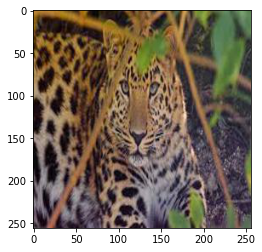

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


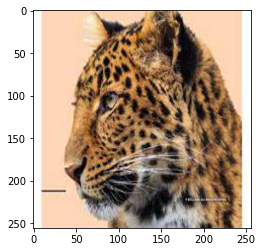

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


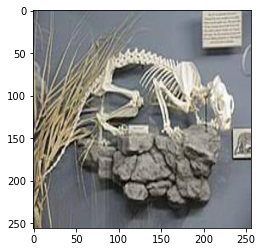

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


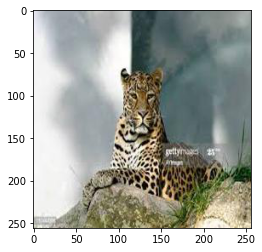

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


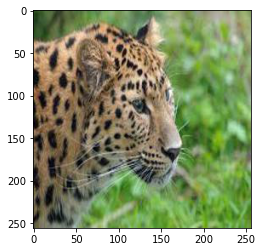

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


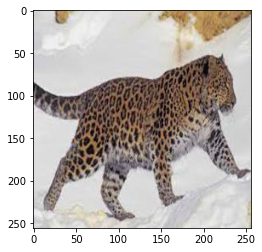

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


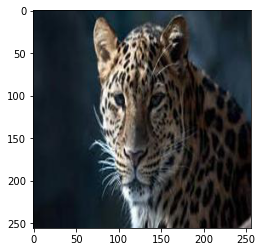

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


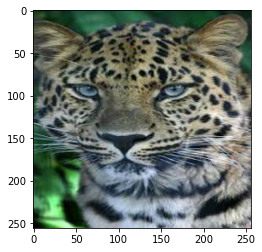

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


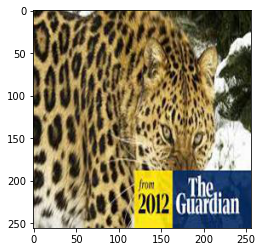

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


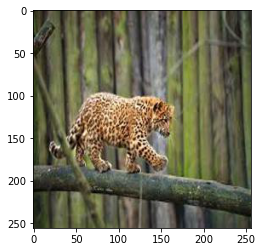

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


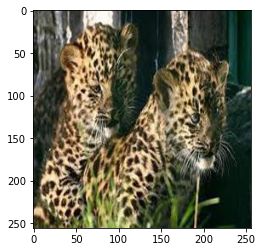

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


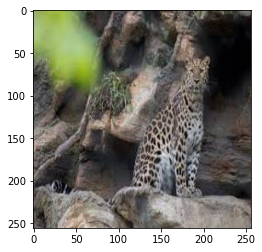

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


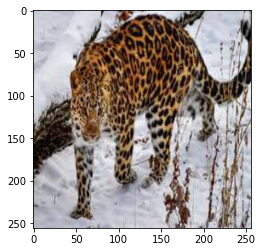

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


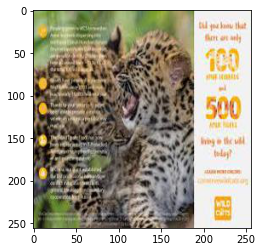

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


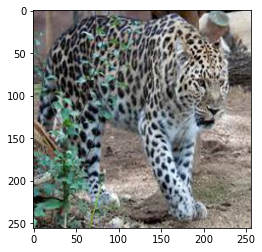

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


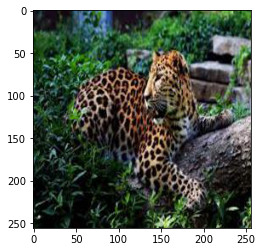

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


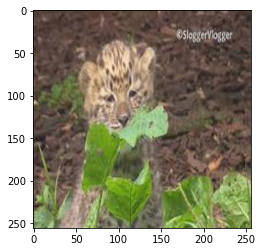

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


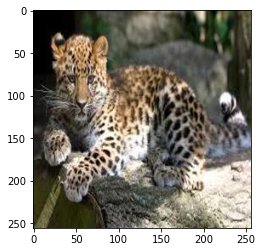

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


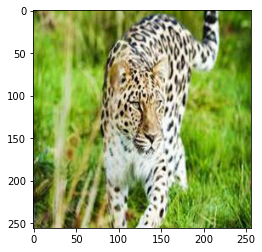

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


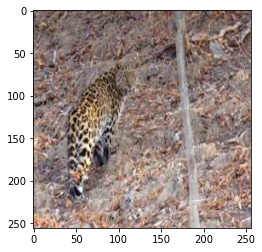

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


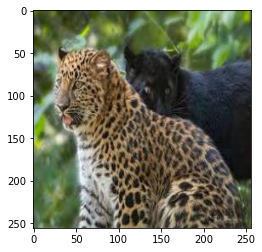

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


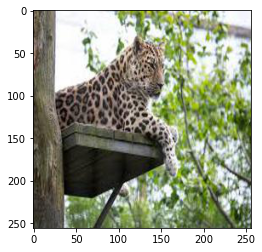

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


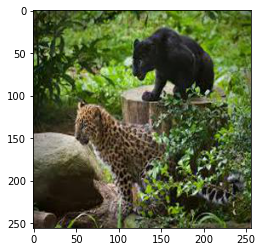

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


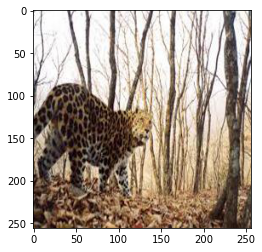

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


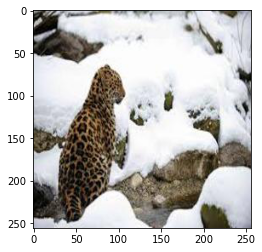

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


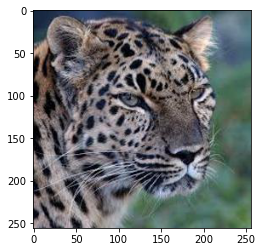

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


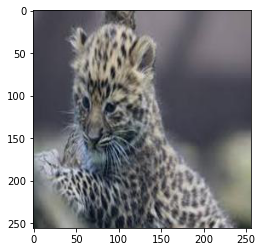

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


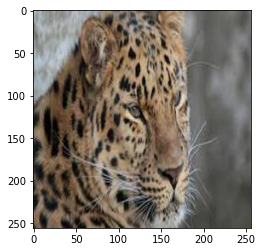

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


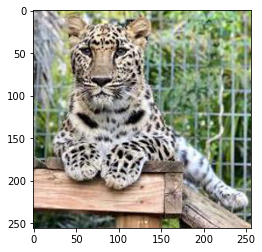

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


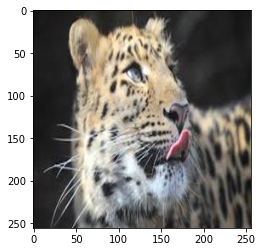

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


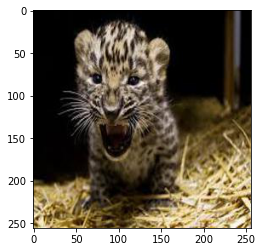

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


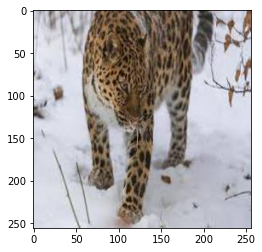

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


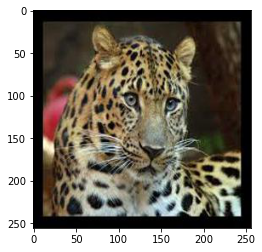

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


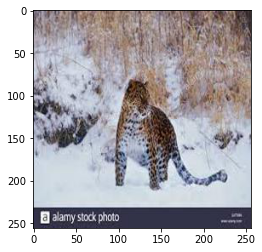

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


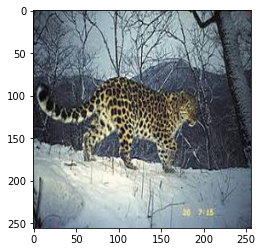

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


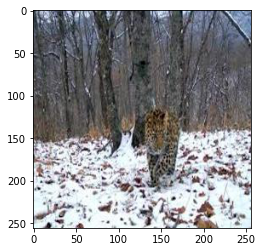

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


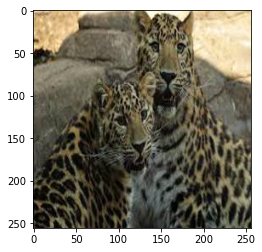

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


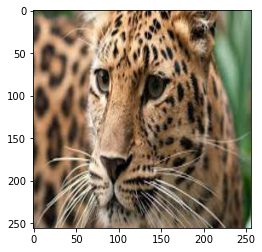

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


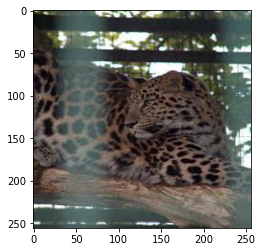

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


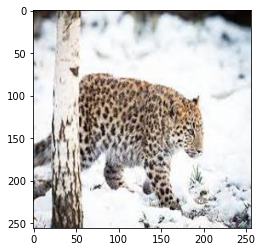

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


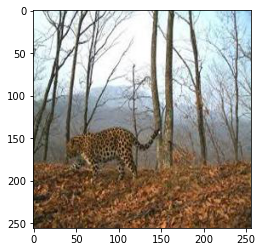

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


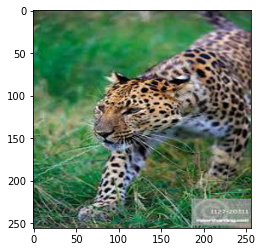

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


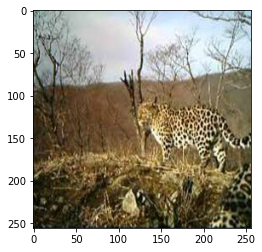

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


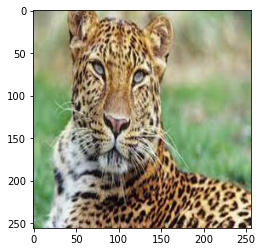

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


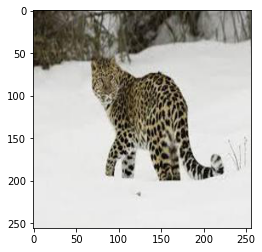

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


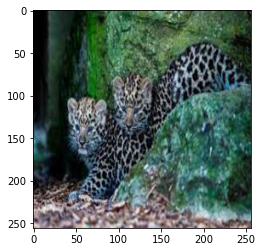

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


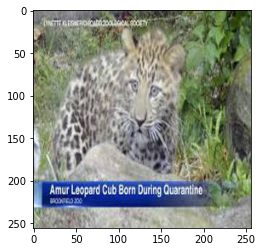

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


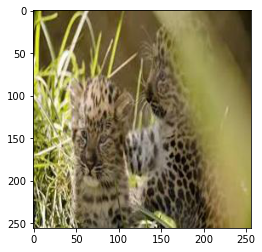

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


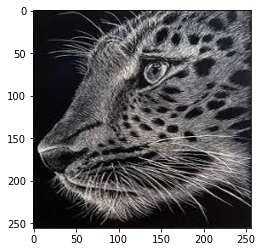

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


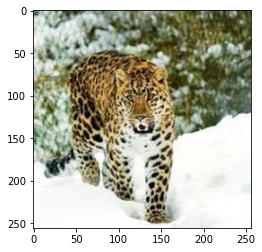

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


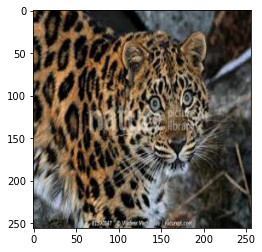

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


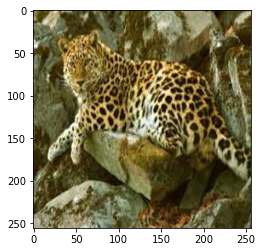

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


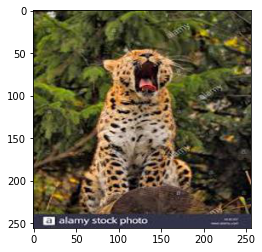

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


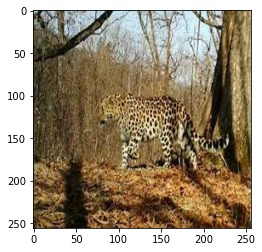

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


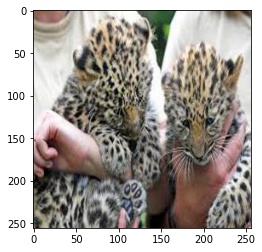

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


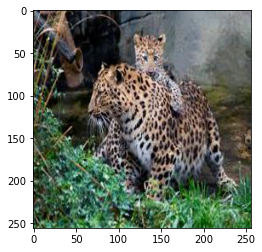

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


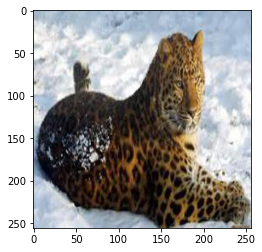

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


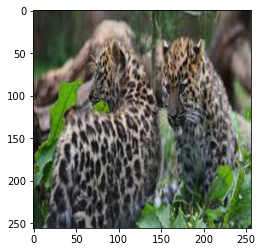

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


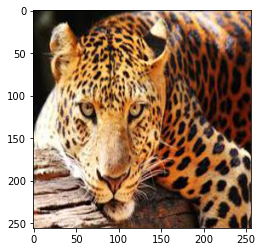

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


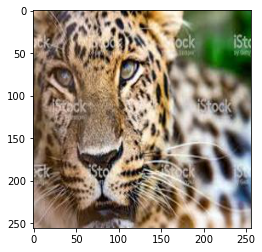

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


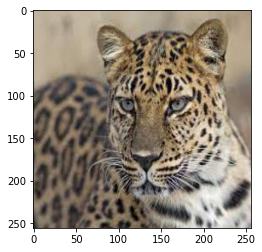

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


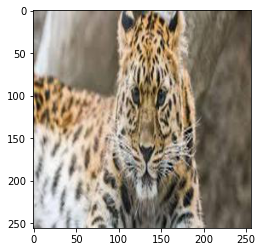

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


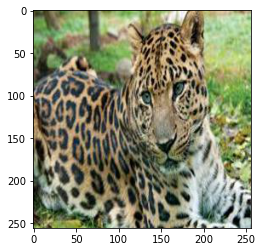

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


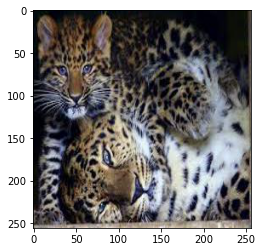

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


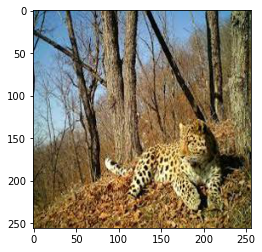

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


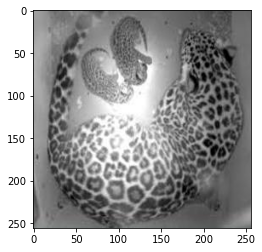

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


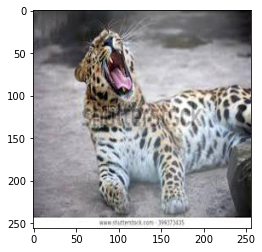

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


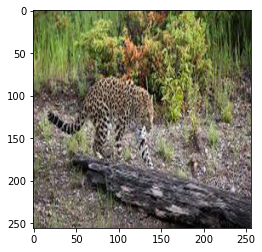

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


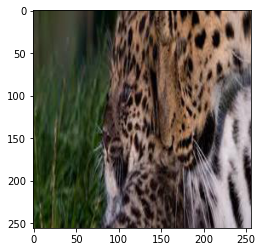

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


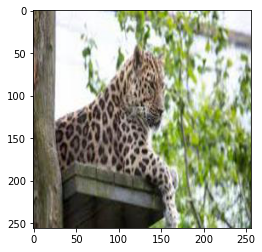

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


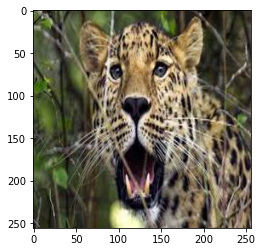

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


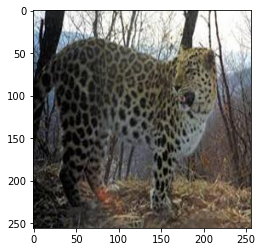

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


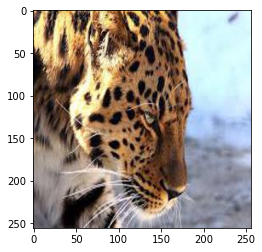

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


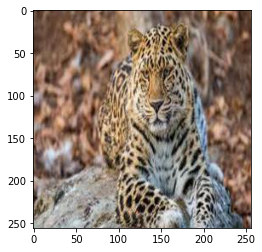

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


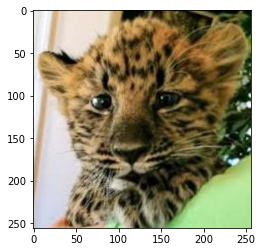

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


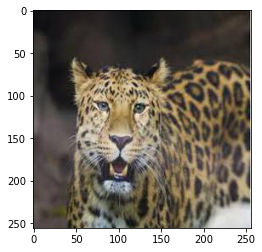

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


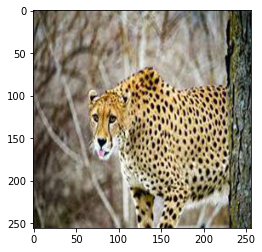

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


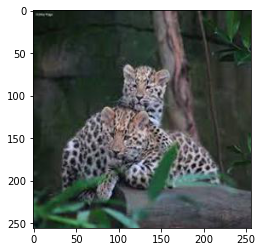

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


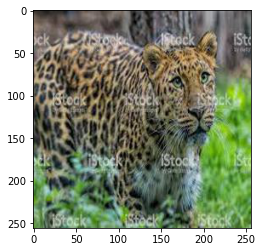

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


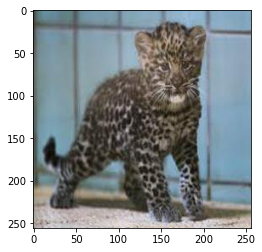

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


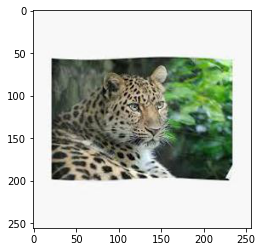

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


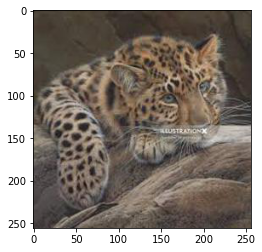

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


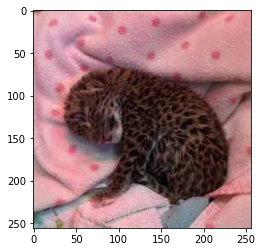

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


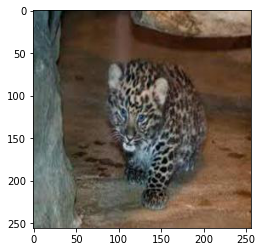

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


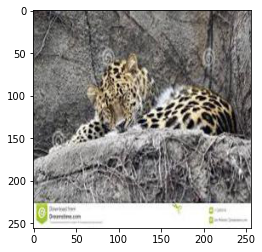

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


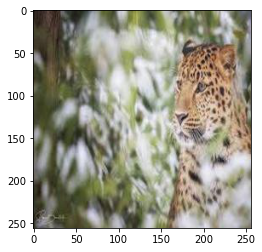

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


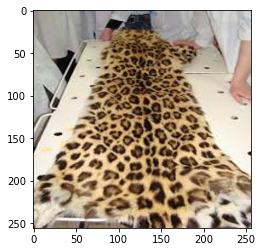

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


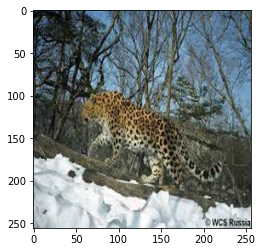

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


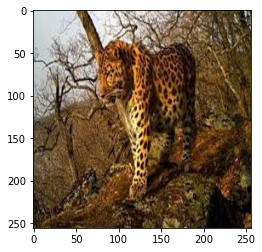

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


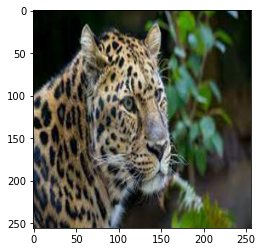

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


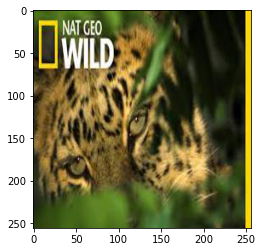

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


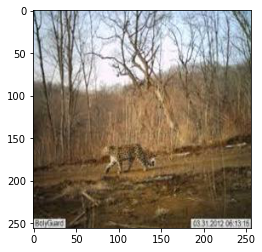

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


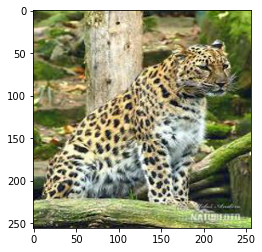

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


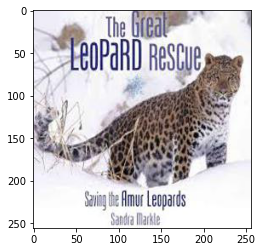

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


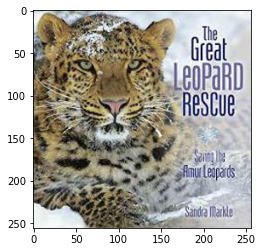

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


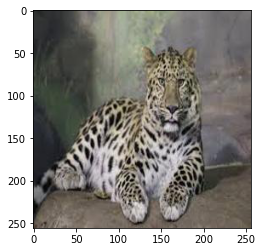

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


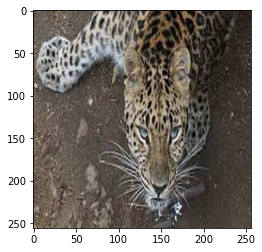

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


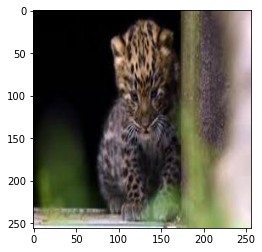

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


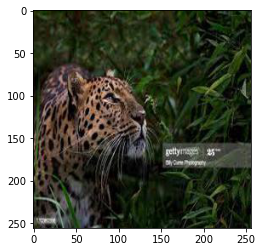

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


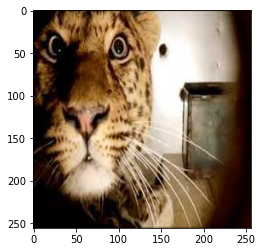

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


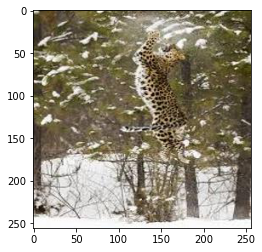

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


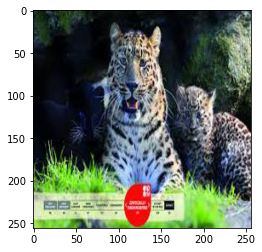

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


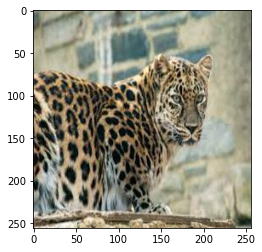

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


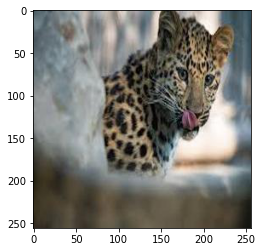

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


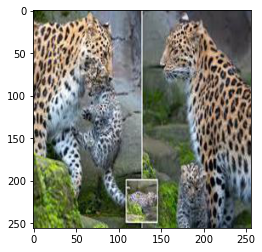

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


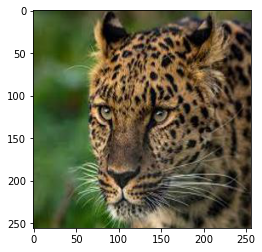

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


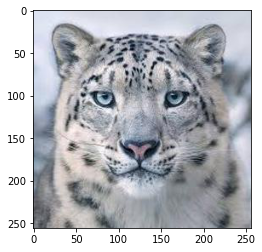

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


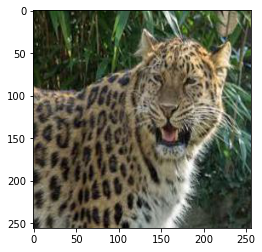

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


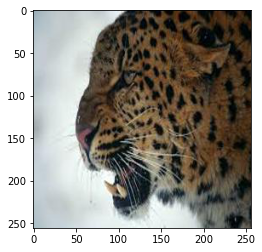

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


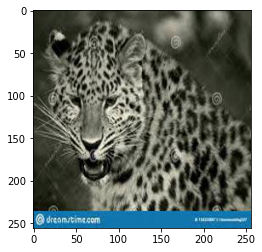

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


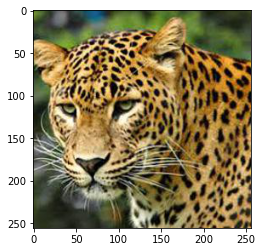

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


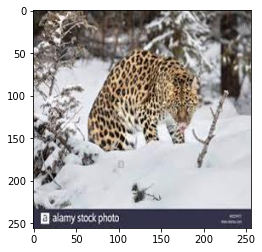

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


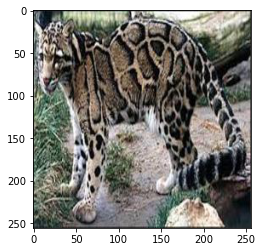

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


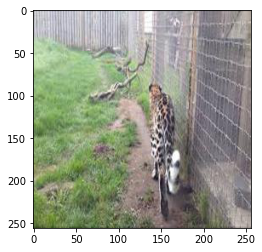

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


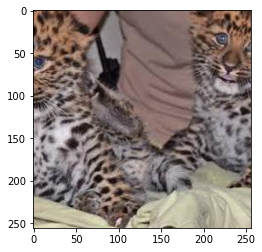

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


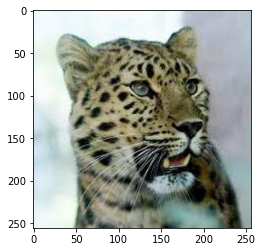

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


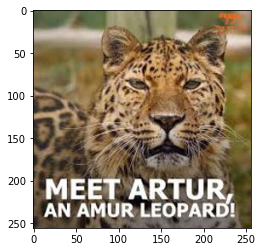

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


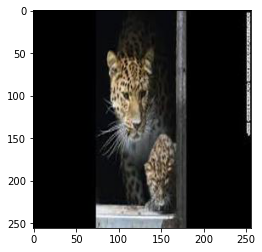

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


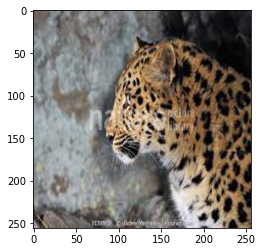

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


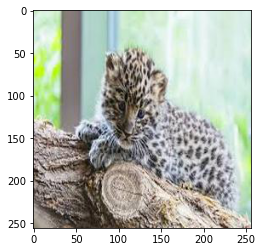

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


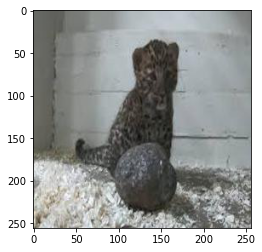

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


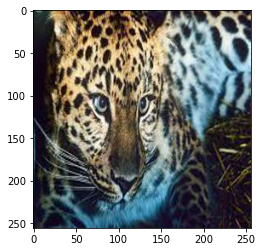

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


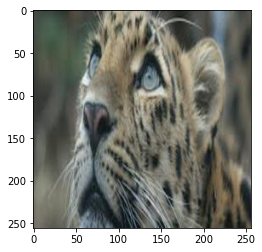

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


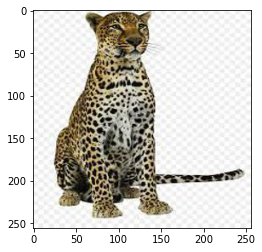

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


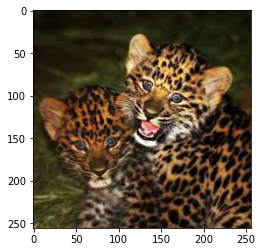

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


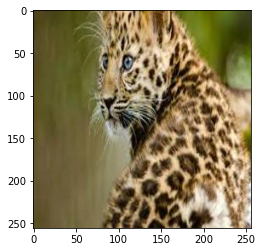

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


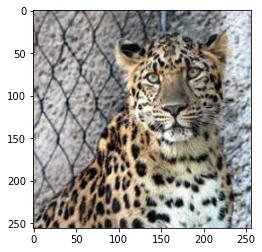

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


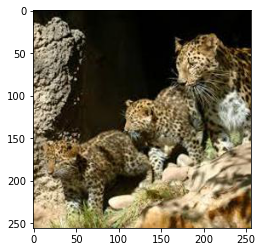

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


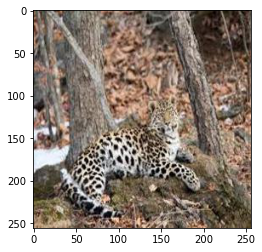

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


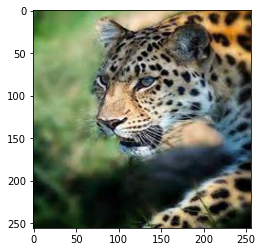

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


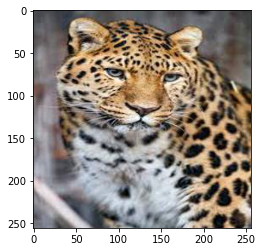

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


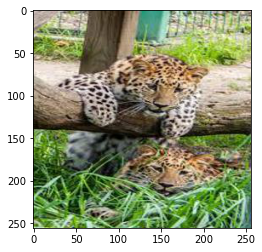

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


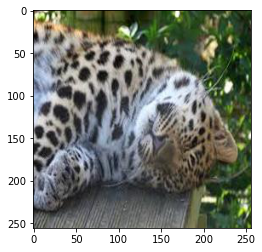

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


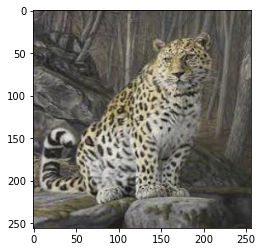

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


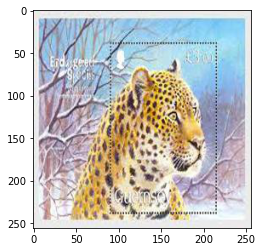

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


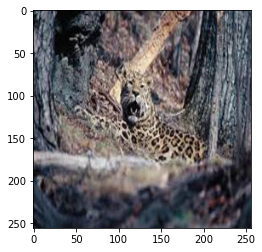

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


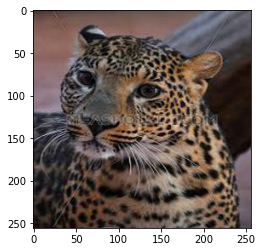

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


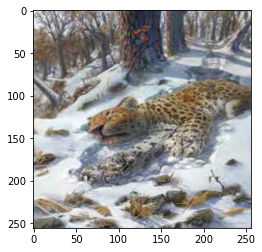

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


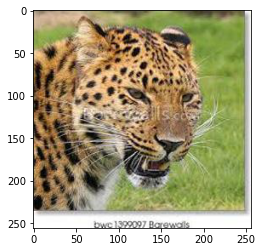

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


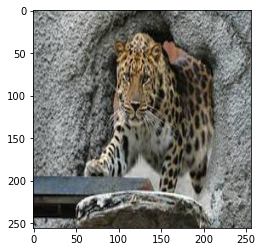

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


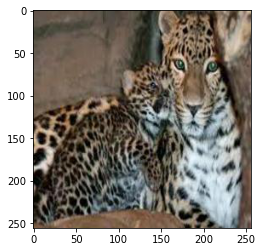

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


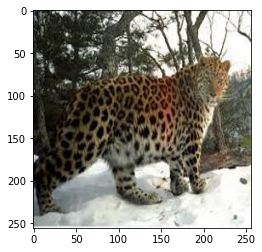

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


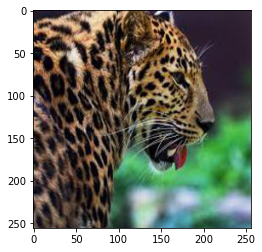

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


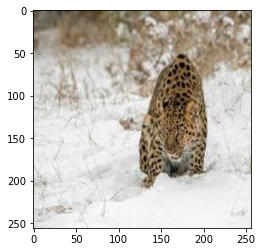

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


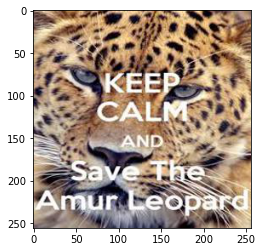

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


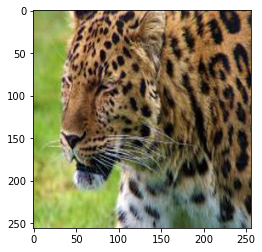

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


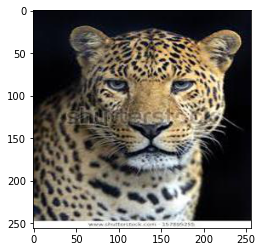

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


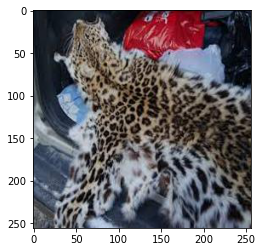

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


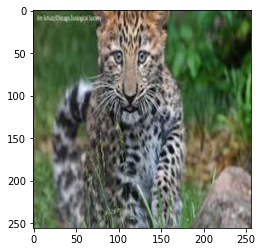

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


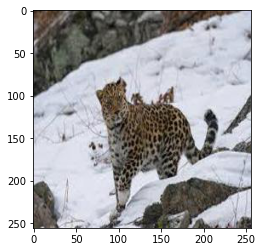

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


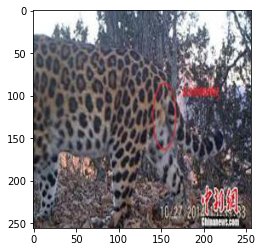

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


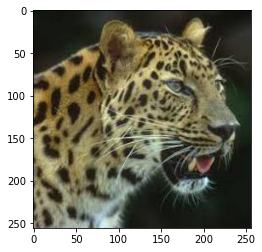

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


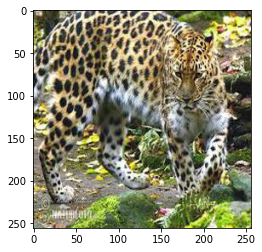

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


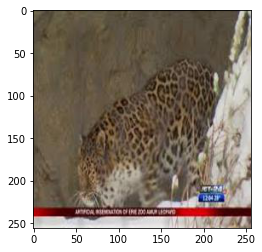

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


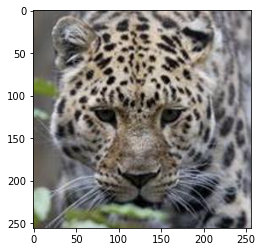

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


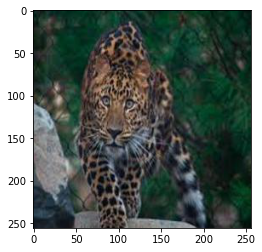

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


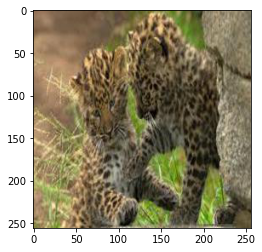

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


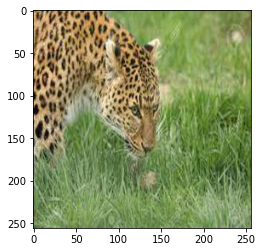

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


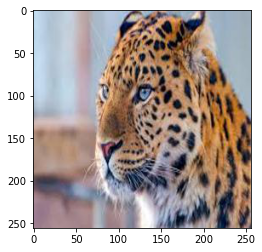

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


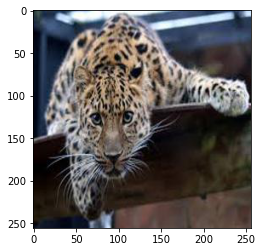

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


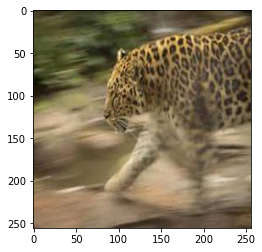

KeyboardInterrupt: 

In [23]:
dir_path = r'F:\programme\Animal species recognition\inital_dataset\Amur Leopard'

for i in os.listdir(dir_path):
    img = image.load_img(dir_path+'//'+i,target_size=(256,256,3))
    plt.imshow(img)
    plt.show()
    
    x=image.img_to_array(img)
    x=np.expand_dims(x,axis=0)
    images=np.vstack([x])
    
    val = model.predict(images)
    print(val)

In [28]:
print(val)
    

[[1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]


In [29]:
type(val)

numpy.ndarray

In [30]:
val.ndim

2

In [40]:
if np.array_equal(val , (np.array([[1, 0, 0, 0, 0, 0, 0, 0, 0,0]], dtype = 'float'))):
    print('a')


a
